In [1]:
# Import the usual libraries
import numpy as np
from sklearn.decomposition import PCA

In [2]:
# We import the functions that implement k-means, DBSCAN and Gaussian Mixture
from sklearn.cluster import KMeans, DBSCAN
from sklearn.mixture import GaussianMixture

In [3]:
from helper_clustering import import_data, visualize, obtain_clusters, info_clusters
from helper_pca import apply_pca
from helper_nn import write_labels, read_labels

In [4]:
# We import the data
directory = "../data"
folderSave = 'Save_3K'
data = import_data(directory, folderSave)

(780, 128, 160)
Before PCA, we have 780 samples, each with 20480 features
After PCA, we have 780 samples, each with 100 features


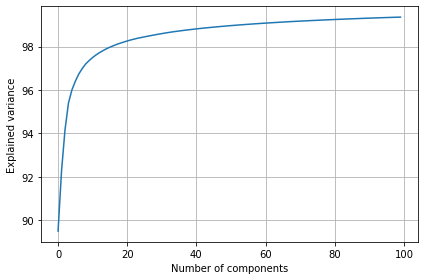

In [5]:
print(data.shape)
n_components = 100
X_pca, imgs_reduced = apply_pca(data, n_components)

In [6]:
np.random.seed(1)

In [7]:
# We have 3 different clusters:
#  * Triangle with overflow
#  * Triangle without overflow
#  * Patatoid with overflow
n = 3

In [8]:
# We classify the data with k-means
kmeans = KMeans(n_clusters=n, init='random')
kmeans.fit(X_pca)
Z = kmeans.predict(X_pca)

cluster 0, 304 elements


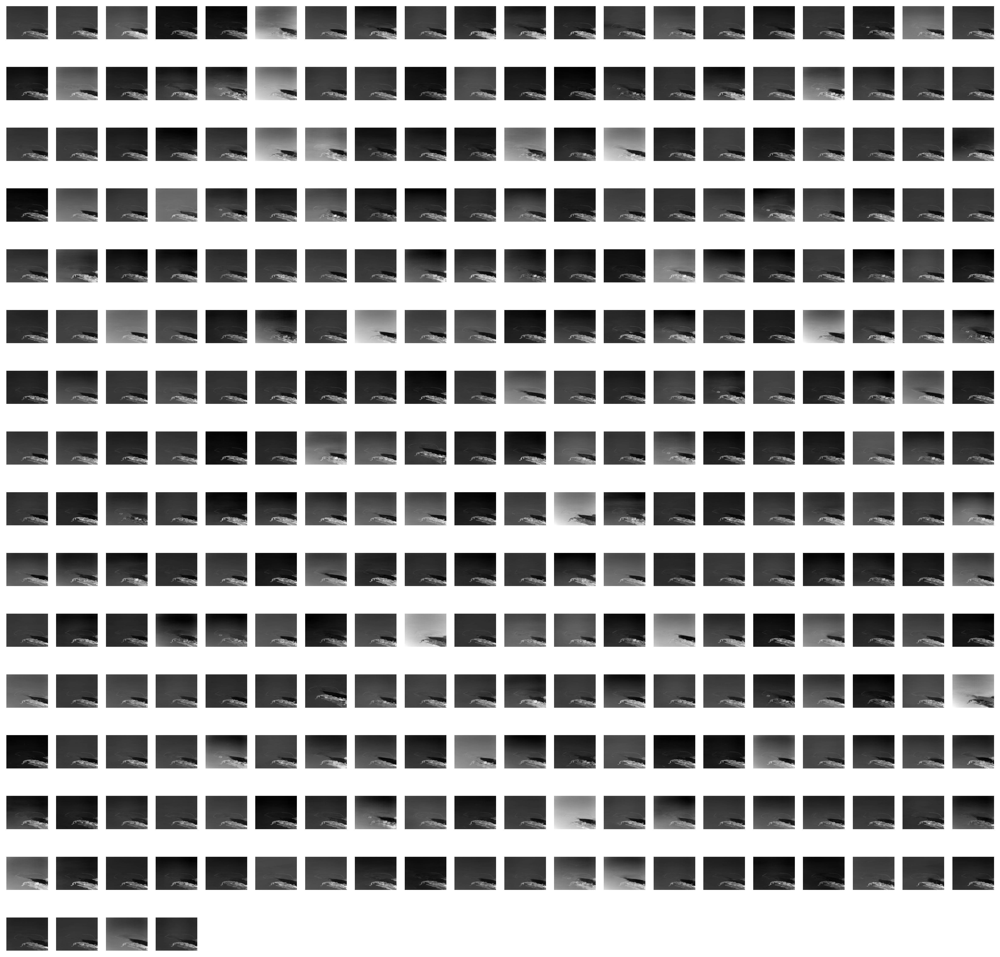

cluster 1, 242 elements


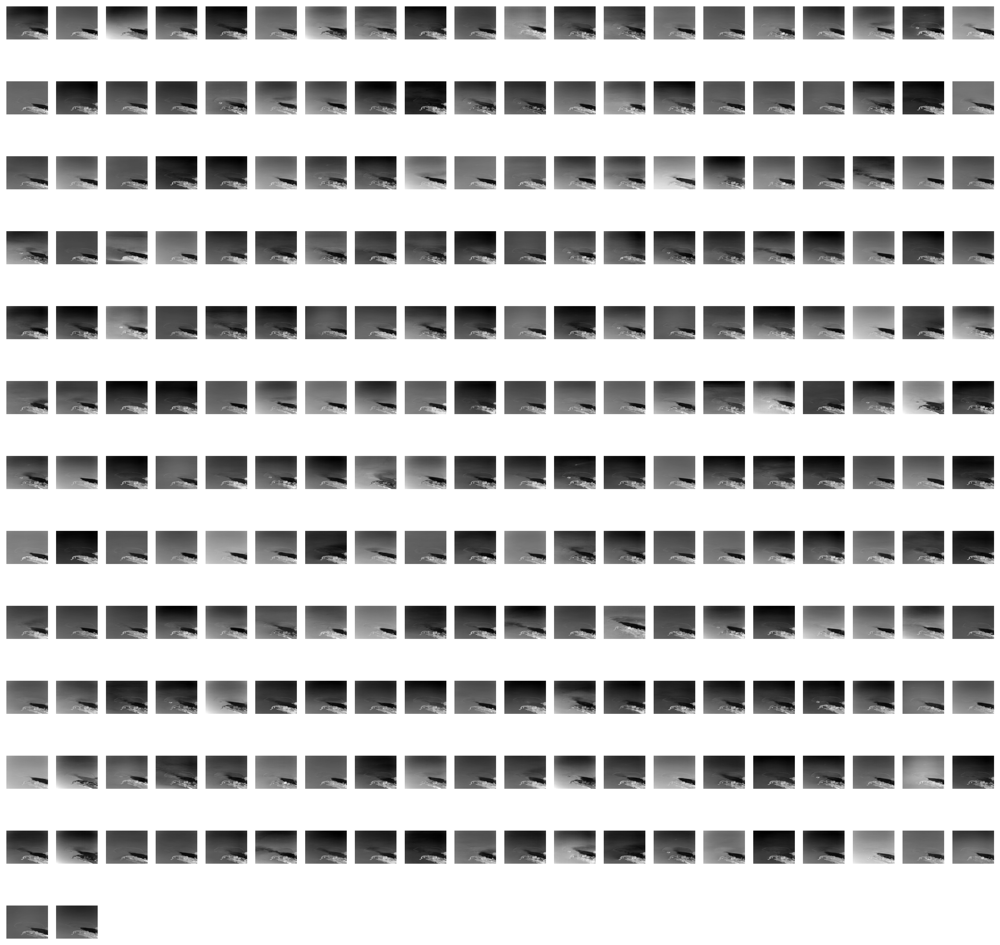

cluster 2, 234 elements


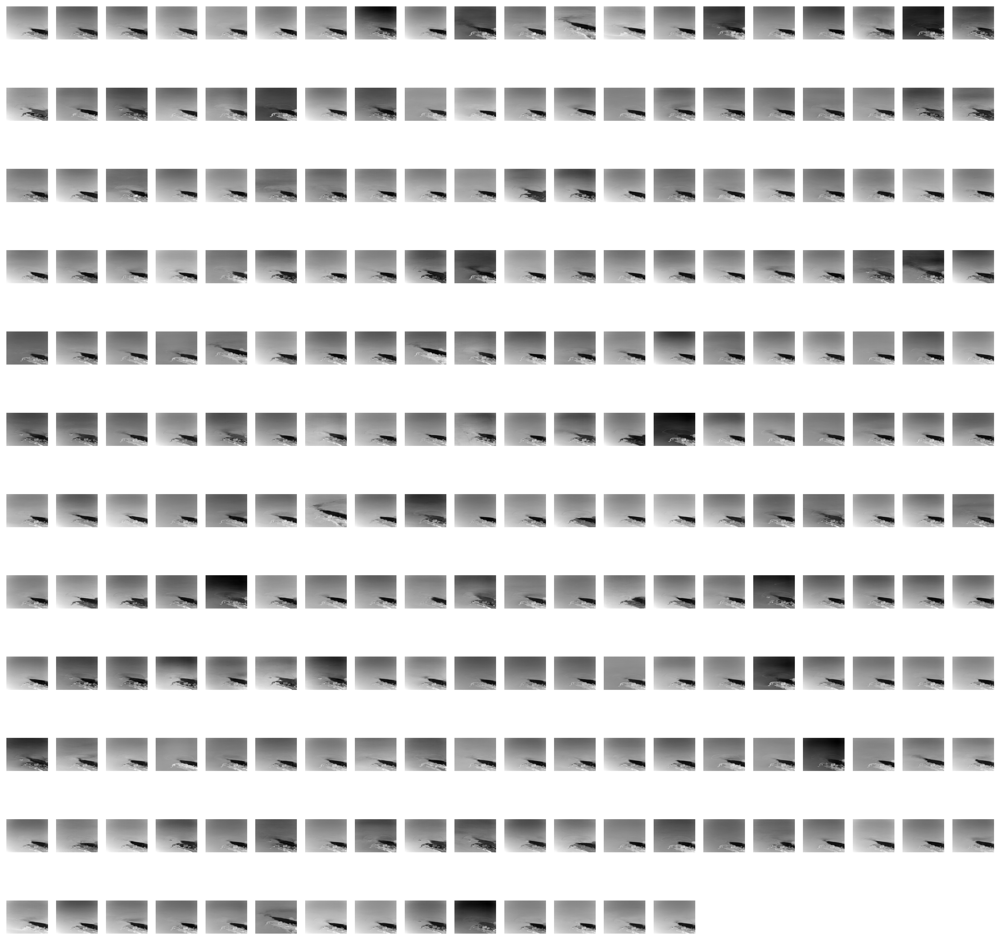

In [9]:
# We plot the resulting clusters
size = 20
visualize(imgs_reduced, Z, size, num_clusters=3)

In [10]:
# Holds the cluster id and the images { id: [images] }
groups = obtain_clusters(folderSave, kmeans.labels_)

In [11]:
# print(f'Cluster 0: {groups[0]} \n')
# print(f'Cluster 1: {groups[1]} \n')
# print(f'Cluster 2: {groups[2]} \n')

In [12]:
# Print the labels created
write_labels(kmeans.labels_, "training_labels.csv")

# Read the labels created
training_labels = read_labels("training_labels.csv")
# print(training_labels)

[0 0 0 2 2 0 1 0 0 0 1 0 2 1 2 2 1 1 0 2 1 2 1 0 1 0 0 0 2 2 0 0 1 2 1 1 1
 2 2 2 0 1 0 0 0 0 0 2 0 0 0 2 0 2 0 2 2 2 1 1 0 2 0 0 1 1 1 1 0 2 0 0 2 0
 1 1 0 0 2 1 1 2 0 1 1 2 2 0 0 1 0 1 0 0 2 1 2 0 1 2 0 0 1 0 0 2 1 1 0 2 0
 0 2 1 0 2 2 2 0 2 2 1 2 0 1 1 2 2 1 1 0 2 2 2 2 2 0 0 0 0 0 0 1 1 0 1 2 0
 0 0 1 2 0 1 2 1 0 1 2 0 2 2 2 1 1 0 1 2 1 2 2 2 1 1 0 0 1 1 2 1 0 0 2 0 2
 0 0 2 2 1 0 1 0 0 2 0 0 0 2 2 0 0 1 0 0 1 1 0 1 2 0 0 1 0 2 1 1 1 2 2 2 1
 1 1 1 2 0 2 2 1 0 2 0 1 0 1 0 1 2 1 1 1 1 2 0 1 0 2 0 1 1 0 2 1 1 1 1 2 2
 1 2 0 0 2 0 1 2 1 1 0 2 0 1 0 2 0 1 2 0 2 1 0 2 1 2 1 0 0 0 0 0 0 0 1 2 2
 0 0 2 2 0 2 2 0 0 1 0 2 2 2 1 0 0 0 1 0 0 2 1 0 2 0 2 2 0 1 2 0 0 0 0 2 2
 0 0 0 0 2 1 2 2 0 0 2 0 2 0 0 1 0 2 0 2 1 1 2 1 0 2 2 2 1 0 2 1 1 1 0 0 0
 0 0 0 1 1 0 2 2 1 0 0 1 1 2 1 2 2 1 2 1 2 1 1 1 2 1 1 1 0 1 0 0 2 1 2 0 2
 0 0 1 0 0 0 2 1 1 2 0 1 2 1 1 0 0 0 1 0 2 2 1 1 0 1 0 2 0 2 0 1 2 0 1 1 0
 1 1 0 2 0 1 0 0 0 1 1 1 2 2 1 0 1 0 2 0 0 1 0 1 1 0 0 2 0 0 0 2 1 1 1 2 2
 0 0 2 0 2 2 1 0 1 1 0 1 

DBSCAN might not work well if your clusters have different densities.

In [13]:
clustering = DBSCAN(eps=3000, min_samples=2).fit(X_pca)
DBSCAN_labels = clustering.labels_
info_clusters(DBSCAN_labels, n)

Number of clusters: 6
Cluster 0 contains 5 elements.
Cluster 1 contains 766 elements.
Cluster 2 contains 2 elements.


In [14]:
# We plot the resulting clusters

### Gaussian Mixture Models

In [15]:
gmm = GaussianMixture(n_components=3)
gmm = gmm.fit(X_pca)

In [16]:
# predictions from gmm
GMM_labels = gmm.predict(X_pca)

In [17]:
Z = gmm.predict(X_pca)

cluster 0, 296 elements


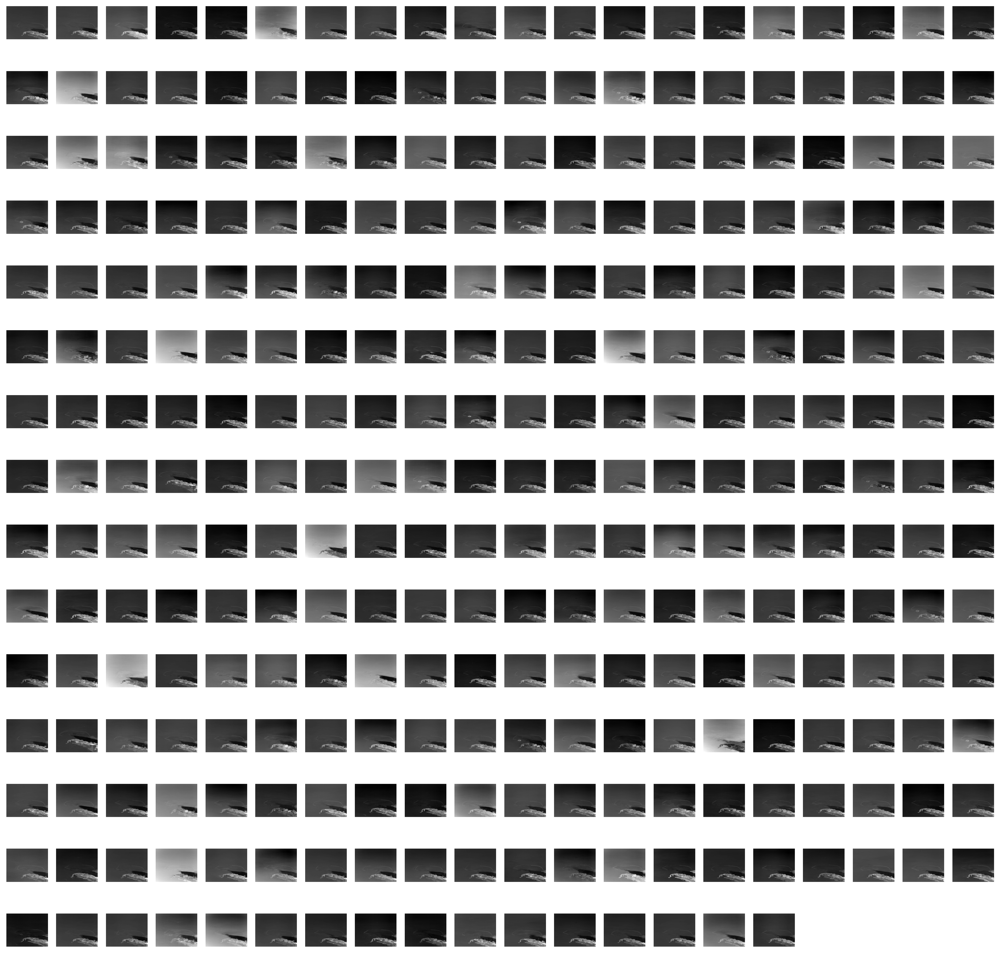

cluster 1, 255 elements


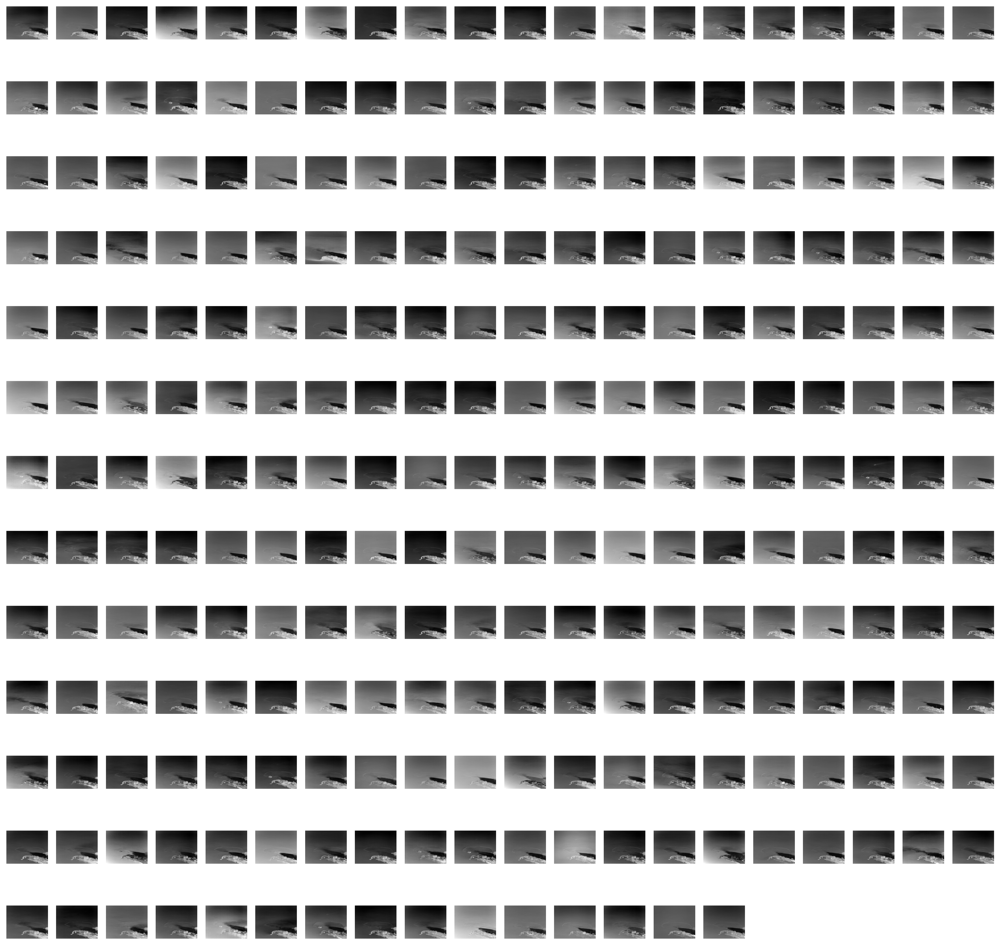

cluster 2, 229 elements


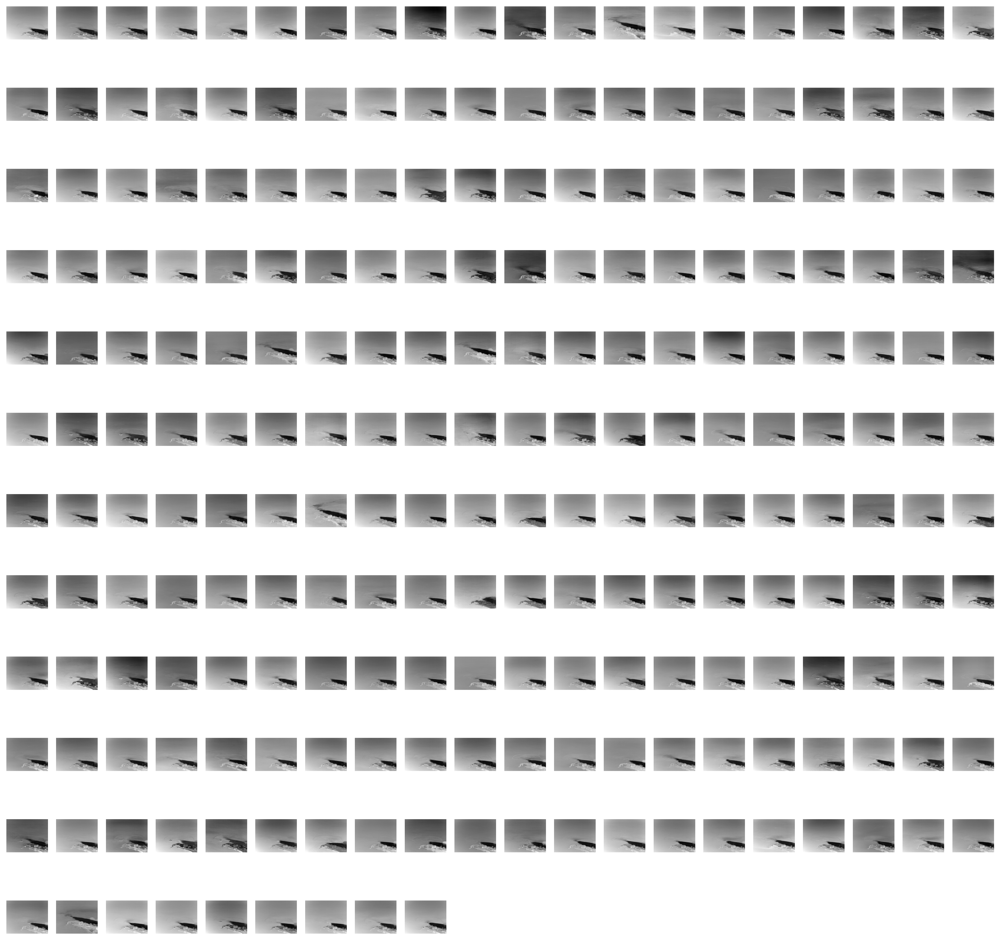

In [18]:
# We plot the resulting clusters
size = 20
visualize(imgs_reduced, Z, size, num_clusters=3)

In [19]:
info_clusters(GMM_labels, n)

Number of clusters: 3
Cluster 0 contains 296 elements.
Cluster 1 contains 255 elements.
Cluster 2 contains 229 elements.
